# 2. Advanced Tutorials - 3. Image Generation - 2. GANs - 2. Pix2Pix

### 목차

1. Import Tensorflow and other libraries
2. Load the dataset
3. Input Pipeline
4. Build the Generator
5. Build the Discriminator
6. Define the loss functions and the optimizer
7. Checkpoints(Object- based saving)
8. Training
9. Generate Images
10. Restore the latest checkpoint and test
11. Testing on the entire test dataset

Dataset : CMP Facade Database : http://cmp.felk.cvut.cz/~tylecr1/facade/ Each Epoch 58s : P100 GPU

## 1. Import Tensorflow and other libraries

In [1]:
from __future__ import absolute_import, division, print_function, unicode_literals

import tensorflow as tf

import numpy as np
import os
import time
import matplotlib.pyplot as plt
from IPython.display import clear_output
print(tf.__version__)

2.0.0-alpha0


https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets 
에는 많은 datasets들이 존재한다.

- cityscapes.tar.gz  2016-12-02 23:15  99M   
- edges2handbags.tar.gz  2016-12-02 23:16  8.0G   
- edges2shoes.tar.gz  2016-12-02 23:17  2.0G   
- facades.tar.gz  2016-12-02 23:17  29M   
- maps.tar.gz  2016-12-02 23:17  239M   

5개가 존재하는데 이 중 우리는 facades.tar.gz 29M를 사용할 것이다.

## 2. Load the dataset

In [2]:
_URL = 'https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets/facades.tar.gz'

path_to_zip = tf.keras.utils.get_file('facades.tar.gz',
                                     origin = _URL,
                                     extract=True)
PATH = os.path.join(os.path.dirname(path_to_zip),'facades/')

In [3]:
path_to_zip

'C:\\Users\\la\\.keras\\datasets\\facades.tar.gz'

In [4]:
os.path.dirname(path_to_zip)

'C:\\Users\\la\\.keras\\datasets'

In [5]:
PATH

'C:\\Users\\la\\.keras\\datasets\\facades/'

실제 PATH 경로에는 train, val, test 디렉토리가 존재한다.<br>
train 400개, test 100개, val 106개의 jpg 확장자 이미지 파일이 존재한다.

In [6]:
BUFFER_SIZE = 400
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [7]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image)
    # tf.image.decode_jpeg == tf.io.decode_image or _jpeg
    
    w = tf.shape(image)[1]
    
    w = w // 2 # 한 개의 jpg 파일에 Segmentation image와 실제 이미지가 같이 붙어있다.
    real_image = image[:, :w, :]
    input_image = image[:, w:, :]
    
    input_image = tf.cast(input_image, tf.float32)
    real_image = tf.cast(real_image, tf.float32)
    
    return input_image, real_image

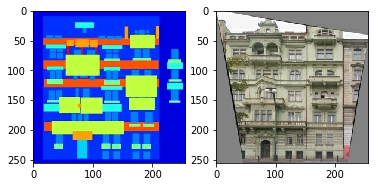

In [8]:
inp, re = load(PATH+'train/100.jpg')

plt.figure()
plt.subplot(1,2,1)
plt.imshow(inp/255.)
plt.subplot(1,2,2)
plt.imshow(re/255.)

In [9]:
inp.shape

TensorShape([256, 256, 3])

max: 255 , min: 0


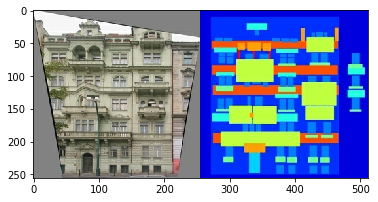

In [10]:
a = tf.io.read_file(PATH+'train/100.jpg')
a = tf.io.decode_image(a)
print('max:',np.max(a),', min:', np.min(a))
plt.figure()
plt.imshow(a)

In [11]:
def resize(input_image, real_image, height, width):
    input_image = tf.image.resize(input_image, [height, width],
                                 method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    real_image = tf.image.resize(real_image, [height, width],
                                 method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

    return input_image, real_image

In [12]:
def random_crop(input_image, real_image):
    stacked_image = tf.stack([input_image, real_image], axis=0)
    cropped_image = tf.image.random_crop(
        stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])
    return cropped_image[0], cropped_image[1]

tf.image.random_crop(
    value,
    size,
    seed=None,
    name=None
)
https://www.tensorflow.org/versions/r2.0/api_docs/python/tf/image/random_crop

(256, 256, 3) (256, 256, 3)


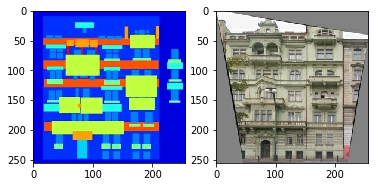

In [13]:
a = random_crop(inp, re)
print(a[0].shape, a[1].shape)

plt.figure()
plt.subplot(1,2,1)
plt.imshow(a[0]/255.)
plt.subplot(1,2,2)
plt.imshow(a[1]/255.)

In [14]:
def normalize(input_image, real_image):
    input_image = (input_image / 127.5) - 1 # [-1,1] <= 0/127.5 -1 = -1, 255/127.5 - 1 = 1
    real_image = (real_image / 127.5) - 1
    
    return input_image, real_image

In [15]:
tf.random.uniform(()) #default [0,1]

<tf.Tensor: id=86, shape=(), dtype=float32, numpy=0.48477972>

In [16]:
@tf.function
def random_jitter(input_image, real_image):
    input_image, real_image = resize(input_image, real_image, 286, 286) #[256,256,3] => [286,286,3]
    input_image, real_image = random_crop(input_image, real_image)
    
    if tf.random.uniform(()) > 0.5:
        input_image = tf.image.flip_left_right(input_image)
        real_image = tf.image.flip_left_right(real_image)
        
    return input_image, real_image

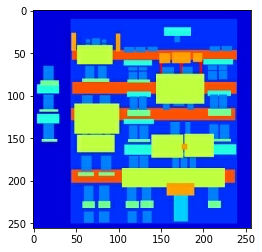

In [17]:
plt.imshow(tf.image.flip_left_right(inp/255.))

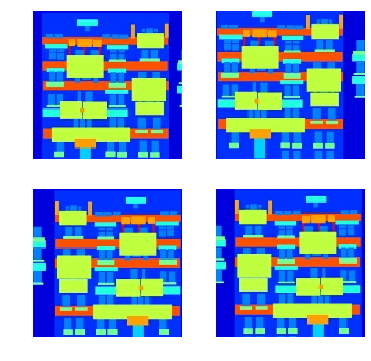

In [18]:
plt.figure(figsize=(6,6))
for i in range(4):
    rj_inp, rj_re = random_jitter(inp, re)
    plt.subplot(2,2, i+1)
    plt.imshow(rj_inp/255.)
    plt.axis('off')
plt.show()

In [19]:
def load_image_train(image_file):
    input_image, real_image = load(image_file)
    input_image, real_image = random_jitter(input_image, real_image)
    input_image, real_image = normalize(input_image, real_image)
    
    return input_image, real_image

In [20]:
def load_image_test(image_file):
    input_image, real_image = load(image_file)
    input_image, real_image = resize(input_image, real_image, IMG_HEIGHT, IMG_WIDTH)
    input_image, real_image = normalize(input_image, real_image)
    
    return input_image, real_image

## 3. Input Pipeline

In [21]:
tf.data.Dataset.list_files(PATH + 'train/*.jpg')

<DatasetV1Adapter shapes: (), types: tf.string>

In [22]:
train_dataset = tf.data.Dataset.list_files(PATH + 'train/*.jpg')
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.map(load_image_train,
                                 num_parallel_calls = tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.batch(1)

In [23]:
train_dataset

<DatasetV1Adapter shapes: ((None, 256, 256, 3), (None, 256, 256, 3)), types: (tf.float32, tf.float32)>

In [24]:
test_dataset = tf.data.Dataset.list_files(PATH+'test/*.jpg')
# shuffling so that for every epoch a different image is generated
# to predict and display the progress of our model.
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(1)

map()

num_parallel_calls: (Optional.) A tf.int32 scalar tf.Tensor, representing the number elements to process asynchronously in parallel. If not specified, elements will be processed sequentially. If the value tf.data.experimental.AUTOTUNE is used, then the number of parallel calls is set dynamically based on available CPU.

## 4. Build the Generator

In [25]:
OUTPUT_CHANNELS = 3

In [26]:
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, 
                                      padding='same',
                                      kernel_initializer=initializer, 
                                      use_bias=False))
    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())
        
    result.add(tf.keras.layers.LeakyReLU())
    
    return result

In [27]:
tf.expand_dims(inp, 0).shape

TensorShape([1, 256, 256, 3])

(256 - 4 + 2*1) / 2 + 1 = 254/2 + 1 = 127+1 = 128

In [28]:
down_model = downsample(3,4)
down_result = down_model(tf.expand_dims(inp, 0))
print(down_result.shape)

#down_result = down_model(inp)
#ValueError: Input 0 of layer sequential_1 is incompatible with the layer: expected ndim=4, 
#found ndim=3. Full shape received: [256, 256, 3]

(1, 128, 128, 3)


In [29]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                padding='same',
                                kernel_initializer=initializer,
                                use_bias=False))

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())

    return result

In [30]:
up_model = upsample(3,4)
up_result = up_model(down_result)
print(up_result.shape)

(1, 256, 256, 3)


In [31]:
def Generator():
    down_stack = [
        downsample(64, 4, apply_batchnorm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
    ]
    
    up_stack = [
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4),
        upsample(256, 4),
        upsample(128, 4),
        upsample(64, 4),
    ]
    
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                          strides=2,
                                          padding='same',
                                          kernel_initializer=initializer,
                                          activation='tanh')
    
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[None, None, 3])
    x = inputs
    
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
        
    skips = reversed(skips[:-1])
    
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
        
    x = last(x)
    
    return tf.keras.Model(inputs=inputs, outputs=x)

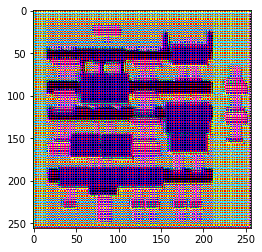

In [32]:
generator = Generator()

gen_output = generator(inp[tf.newaxis,...], training=False)
plt.imshow(gen_output[0,...]*0.5+0.5)

In [33]:
print(inp.shape)
print(inp[tf.newaxis,...].shape)
print(gen_output.shape)
print(np.max(gen_output), np.min(gen_output))

(256, 256, 3)
(1, 256, 256, 3)
(1, 256, 256, 3)
1.0 -1.0


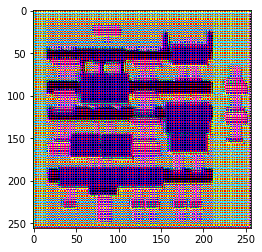

In [34]:
plt.imshow(gen_output[0,...] * 0.5 + 0.5)

1.0 0.0


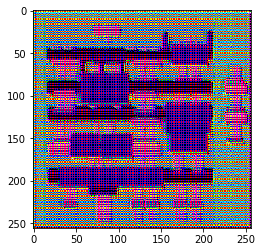

In [35]:
clip = tf.clip_by_value(gen_output[0,...], 0, 255)
print(np.max(clip), np.min(clip))
plt.imshow(clip)

## 5. Build the Discriminator

In [36]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    
    inp = tf.keras.layers.Input(shape=[None, None, 3], name='input_image')
    tar = tf.keras.layers.Input(shape=[None, None, 3], name='target_image')
    
    x = tf.keras.layers.concatenate([inp,tar])
    
    down1 = downsample(64, 4, False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)
    
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                 kernel_initializer=initializer,
                                 use_bias=False)(zero_pad1)
    batchnorm1 = tf.keras.layers.BatchNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)
    
    last = tf.keras.layers.Conv2D(1, 4, strides=1, 
                                 kernel_initializer=initializer)(zero_pad2)
    
    return tf.keras.Model(inputs=[inp, tar], outputs=last)

tf.keras.layers.concatenate(
    inputs,
    axis=-1,
    **kwargs
)

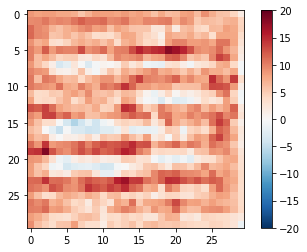

In [37]:
discriminator = Discriminator()
disc_out = discriminator([inp[tf.newaxis,...], gen_output], training=False)
plt.imshow(disc_out[0,...,-1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [38]:
print(inp[tf.newaxis,...].shape, gen_output.shape, disc_out.shape, disc_out[0,...,-1].shape, disc_out[0,...].shape)

(1, 256, 256, 3) (1, 256, 256, 3) (1, 30, 30, 1) (30, 30) (30, 30, 1)


In [39]:
disc_out[0,...,-1].shape

TensorShape([30, 30])

## 6. Define the loss functions and the optimizer

In [40]:
LAMBDA = 100

In [41]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [42]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
    
    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
    
    total_disc_loss = real_loss + generated_loss
    
    return total_disc_loss

In [43]:
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)
    
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    
    total_gen_loss = gan_loss + (LAMBDA * l1_loss)
    
    return total_gen_loss

In [44]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

## 7. Checkpoints(Object- based saving)

In [45]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## 8. Training

## 9. Generate Images

In [46]:
EPOCHS = 200

In [47]:
if not os.path.isdir('./pix2pix_images'):
    os.makedirs('./pix2pix_images')

In [48]:
def generate_images(model, test_input, tar, epoch=0):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15,15))
    
    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']
    
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5) #[-1,1] => [-0.5, 0.5] + 0.5 => [0,1]
        plt.axis('off')
    plt.savefig('./pix2pix_images/epoch_{:03d}.png'.format(epoch))
    plt.show()

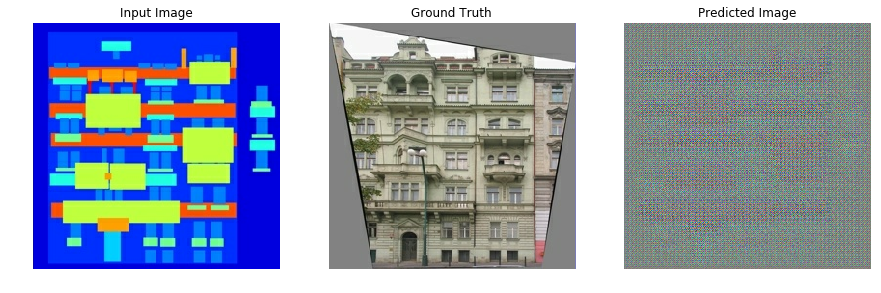

In [49]:
generate_images(generator, (inp[tf.newaxis,...]-127.5) / 127.5, (re[tf.newaxis,...]-127.5) / 127.5, epoch=0)

In [50]:
@tf.function
def train_step(input_image, target):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)
        
        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)
        
        gen_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)
        
    generator_gradients = gen_tape.gradient(gen_loss,
                                           generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss,
                                                discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

In [51]:
def train(dataset, epochs):
    for epoch in range(epochs):
        start = time.time()

        for input_image, target in dataset:
            train_step(input_image, target)

        clear_output(wait=True)
        for inp, tar in test_dataset.take(1):
            generate_images(generator, inp, tar, epoch)

        print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1, time.time()-start))

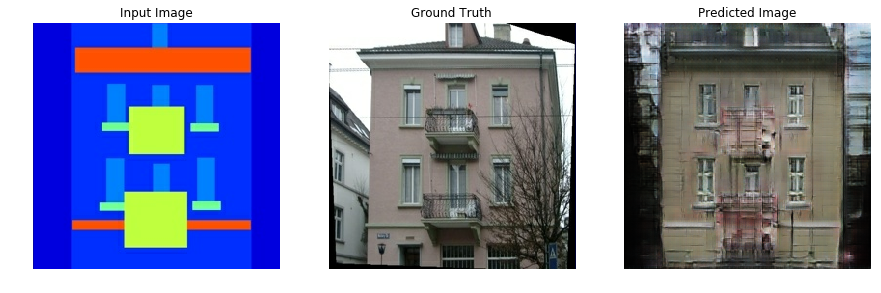

Time taken for epoch 200 is 40.57158160209656 sec



In [52]:
train(train_dataset, EPOCHS)

## 10. Restore the latest checkpoint and test

## 11. Testing on the entire test dataset

In [56]:
def generate_test_images(model, test_input, tar, epoch=0):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15,15))
    
    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']
    
    if not os.path.isdir('./pix2pix_test_images'):
        os.makedirs('./pix2pix_test_images')
    
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5) #[-1,1] => [-0.5, 0.5] + 0.5 => [0,1]
        plt.axis('off')
    plt.savefig('./pix2pix_test_images/epoch_{:03d}.png'.format(epoch))
    plt.show()
    

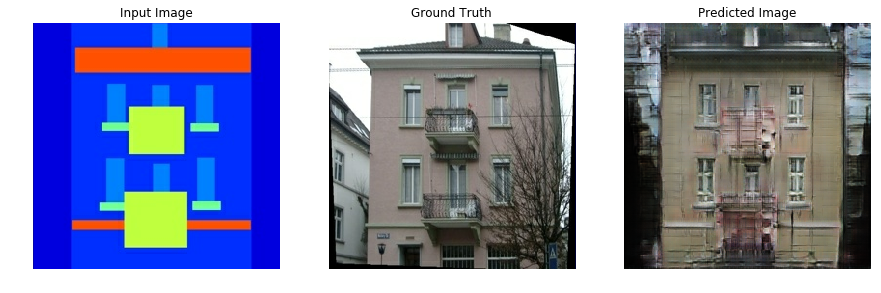

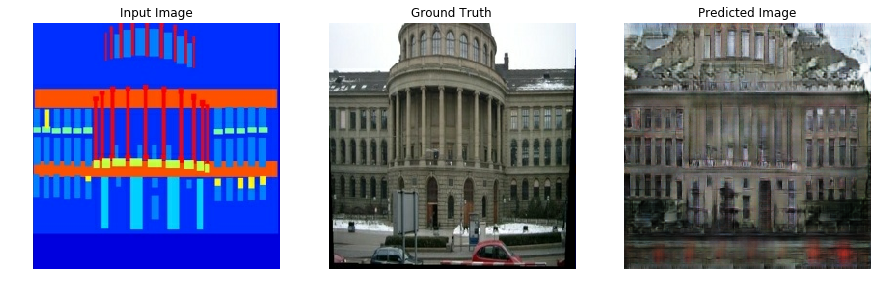

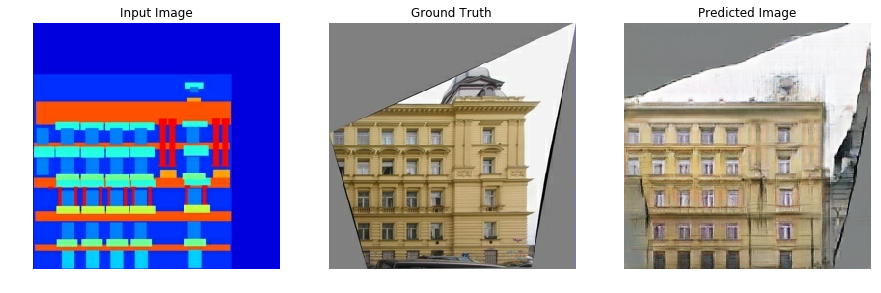

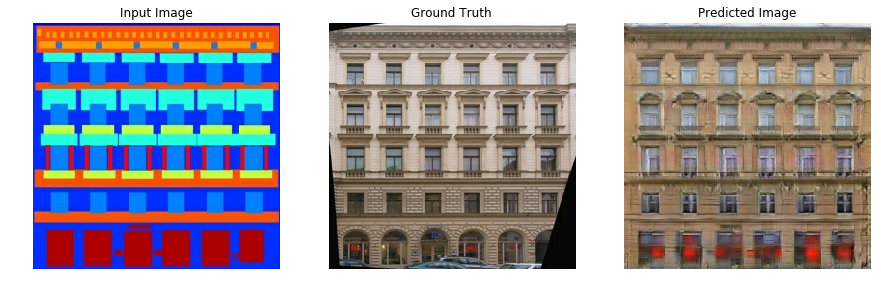

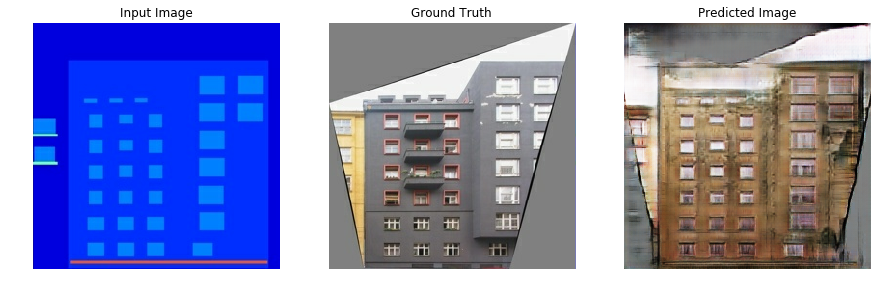

...

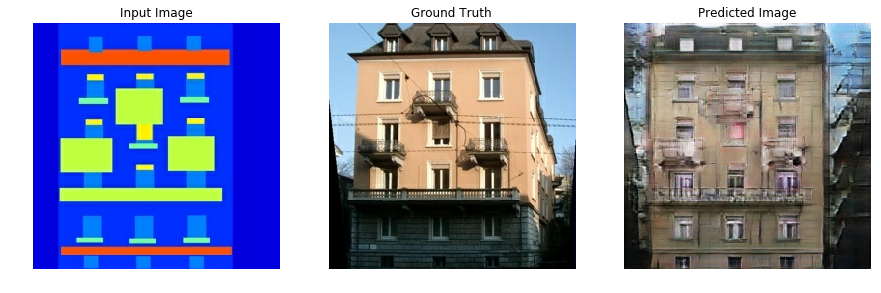

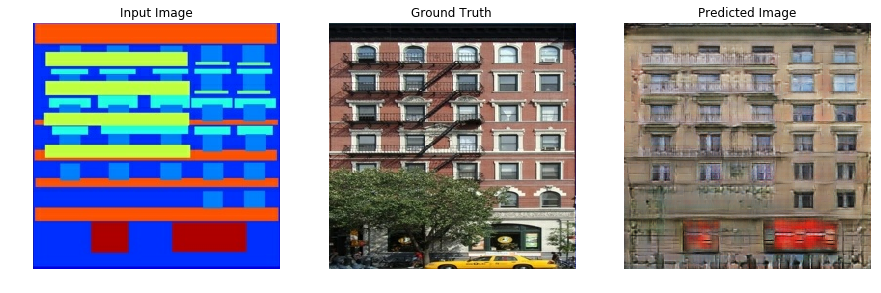

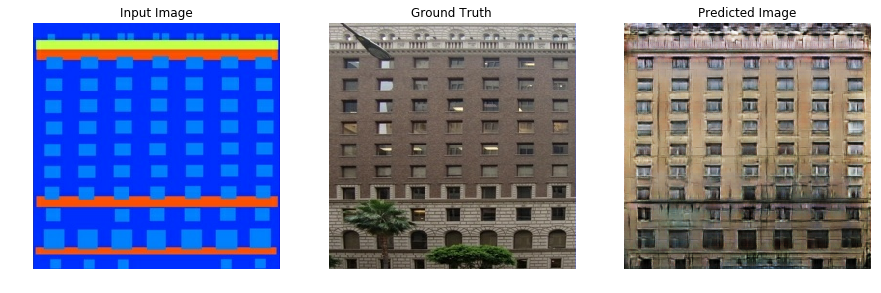

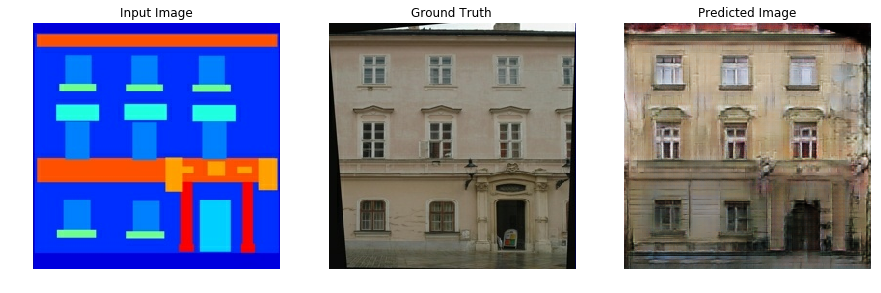

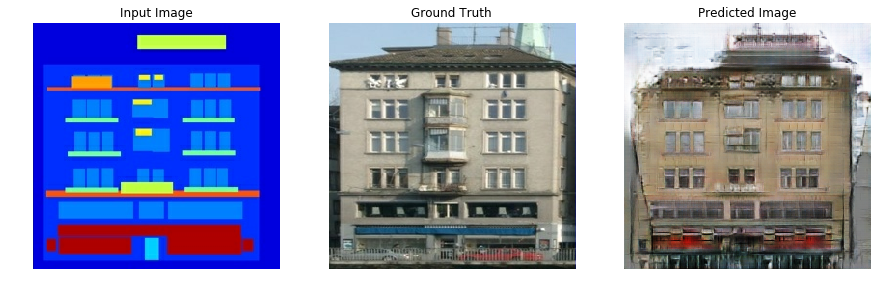

In [57]:
for i, (inp, tar) in enumerate(test_dataset):
    generate_test_images(generator, inp, tar, i)